In [1]:
from dotenv import load_dotenv
import os
load_dotenv()

api_key = os.getenv("XIAOTIAN_API_KEY")
base_url = os.getenv("XIAOTIAN_BASE_URL")

In [2]:
import logging

from autogen_core import EVENT_LOGGER_NAME

logging.basicConfig(level=logging.WARNING)
logger = logging.getLogger(EVENT_LOGGER_NAME)
logger.addHandler(logging.StreamHandler())
logger.setLevel(logging.INFO)

In [3]:
from autogen_ext.models.openai import OpenAIChatCompletionClient

openai_model_client = OpenAIChatCompletionClient(
    model="gpt-4o-2024-08-06",
    api_key=api_key,
    base_url=base_url
)

In [4]:
# from autogen_core.models import UserMessage

# result = await openai_model_client.create([UserMessage(content="What is the capital of France?", source="user")])
# # print(result)
# await openai_model_client.close()


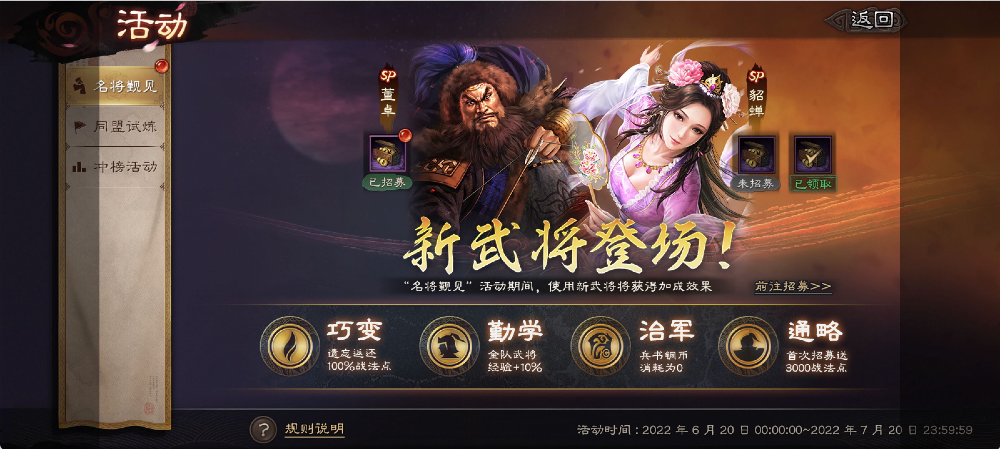

In [11]:
from io import BytesIO

import requests
from autogen_agentchat.messages import MultiModalMessage
from autogen_core import Image as AGImage
from PIL import Image

pil_image = Image.open('../data/image/psd_image.png')
img = AGImage(pil_image)
multi_modal_message = MultiModalMessage(content=["描述图片", img], source="User")
img

In [6]:
from autogen_agentchat.agents import AssistantAgent
from autogen_agentchat.messages import StructuredMessage
from autogen_agentchat.ui import Console

agent = AssistantAgent(
    name="assistant",
    model_client=openai_model_client,
    system_message="solve tasks.",
)

{"tools": [], "type": "LLMCall", "messages": [{"content": "solve tasks.", "role": "system"}, {"role": "user", "name": "User", "content": [{"type": "text", "text": "Can you describe the content of this image?"}, {"type": "image_url", "image_url": {"url": "", "detail": "auto"}}]}, {"role": "assistant", "content": "The image appears to be a promotional screen from a game, likely with a historical or fantasy theme. It features two characters prominently: a fierce-looking man in armor and a woman in traditional, ornate clothing. The text is in Chinese, with phrases such as \"\u65b0\u6b66\u5c06\u767b\u573a!\" meaning \"New Generals Arrive!\" The screen offers options and activities related to these characters, possibly introducing new elements or updates. There is a menu on the left side with various choices, and at the bottom, there are icons and text describing different features or bonuses. The date at the bottom indicates a timeframe for the event."}, {"role": "user", "name": "User", "co
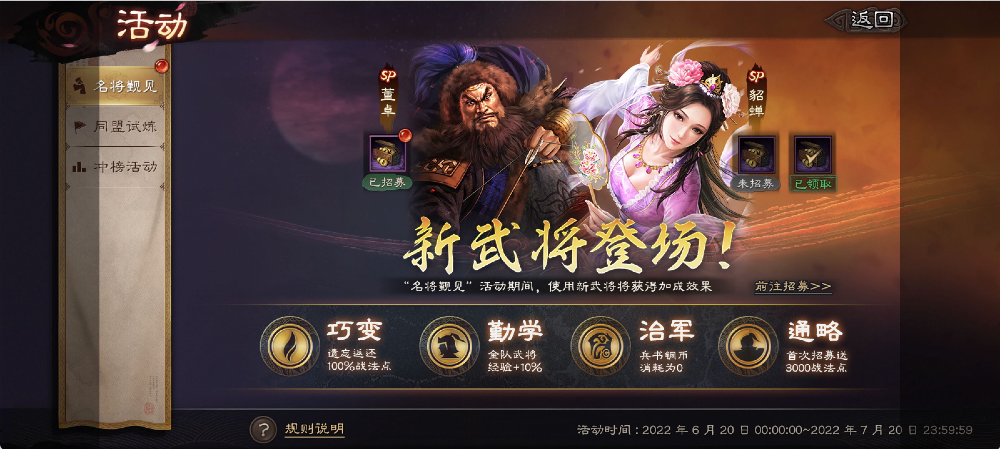
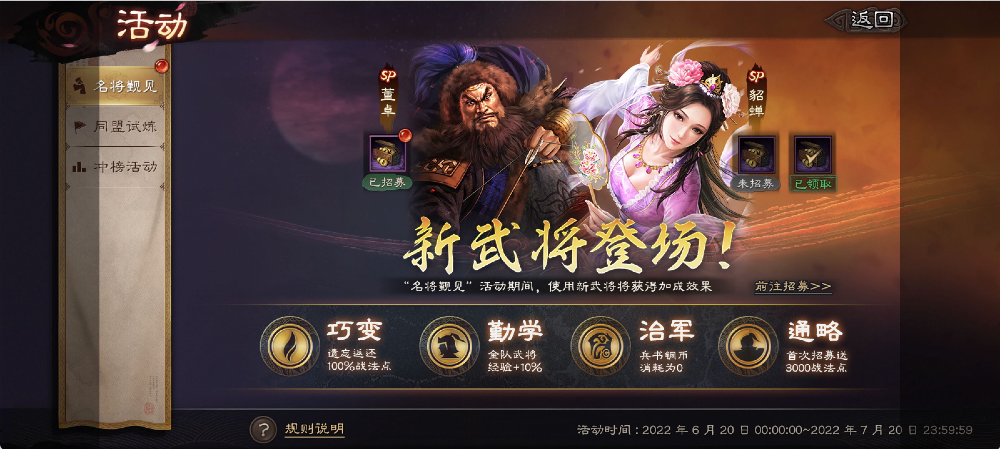
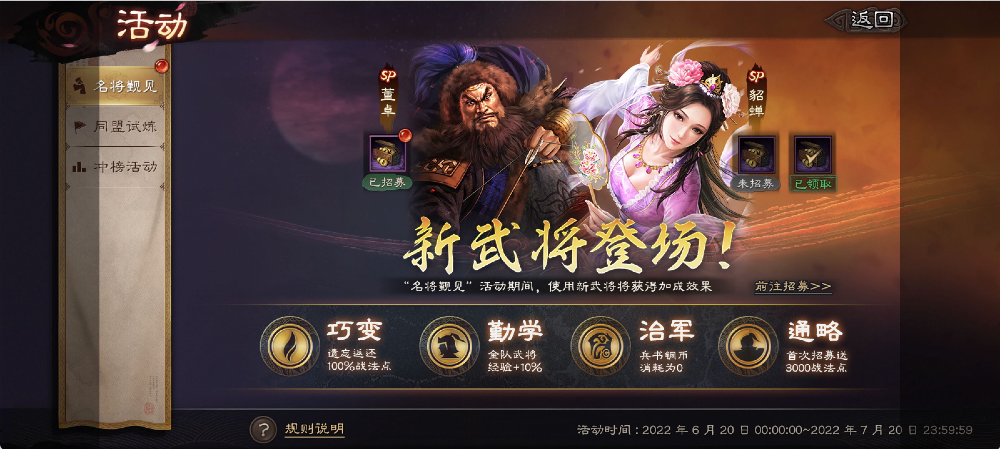
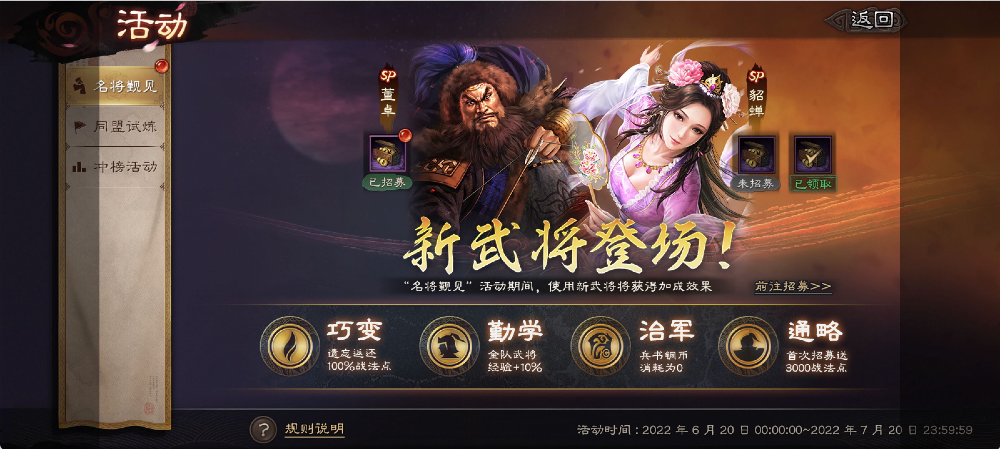

[MultiModalMessage(id='af70bc72-4024-4cf9-8295-f4f21d4d285f', source='User', models_usage=None, metadata={}, created_at=datetime.datetime(2025, 7, 11, 9, 0, 29, 173294, tzinfo=datetime.timezone.utc), content=['描述图片', <autogen_core._image.Image object at 0x11161b380>], type='MultiModalMessage'), TextMessage(id='cfb39769-3167-41d4-8f0a-a783ff9074b2', source='assistant', models_usage=RequestUsage(prompt_tokens=3051, completion_tokens=156), metadata={}, created_at=datetime.datetime(2025, 7, 11, 9, 0, 51, 608400, tzinfo=datetime.timezone.utc), content='这是一幅游戏活动界面图片。图片中出现两个角色：一个是穿着盔甲的凶猛男子，另一个是穿着传统华丽服饰的女子。标题写着“新武将登场！”，表示有新的武将角色登场。\n\n左侧有一个菜单，列出不同活动选项。界面下方有四个带图标的选项，分别是“巧变”、“勤学”、“治军”和“通路”，描述了各种功能或奖励。其中“活动时间”列出了活动的具体日期范围，从2022年6月20日至2022年7月20日。右上角有一个返回按钮。整体风格古典而具有历史感。', type='TextMessage')]


In [12]:
# Use asyncio.run(agent.run(...)) when running in a script.
result = await agent.run(task=multi_modal_message)
print(result.messages)

---------- MultiModalMessage (User) ----------
描述图片
<image>


{"tools": [], "type": "LLMCall", "messages": [{"content": "solve tasks.", "role": "system"}, {"role": "user", "name": "User", "content": [{"type": "text", "text": "Can you describe the content of this image?"}, {"type": "image_url", "image_url": {"url": "", "detail": "auto"}}]}, {"role": "assistant", "content": "The image appears to be a promotional screen from a game, likely with a historical or fantasy theme. It features two characters prominently: a fierce-looking man in armor and a woman in traditional, ornate clothing. The text is in Chinese, with phrases such as \"\u65b0\u6b66\u5c06\u767b\u573a!\" meaning \"New Generals Arrive!\" The screen offers options and activities related to these characters, possibly introducing new elements or updates. There is a menu on the left side with various choices, and at the bottom, there are icons and text describing different features or bonuses. The date at the bottom indicates a timeframe for the event."}, {"role": "user", "name": "User", "co
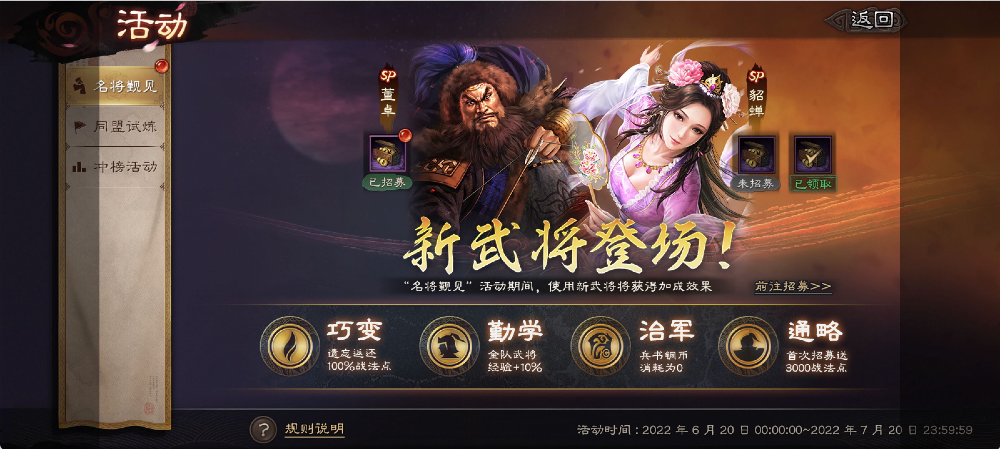
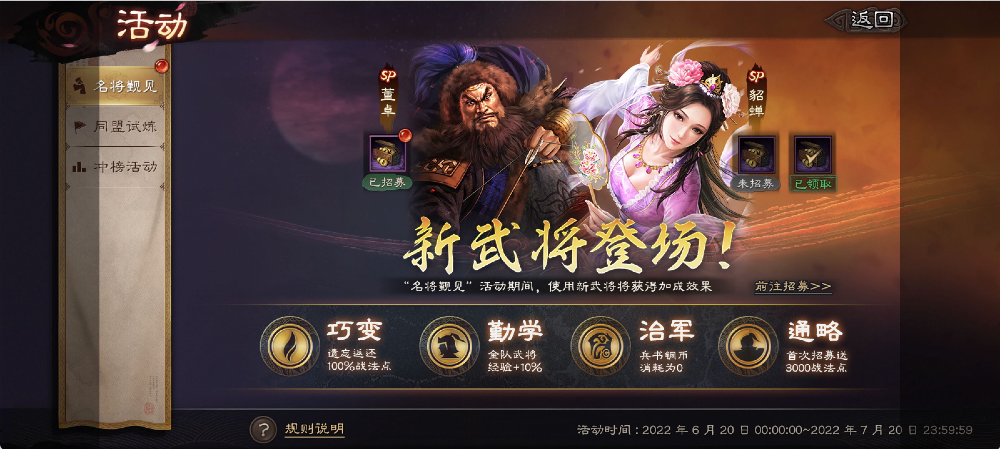
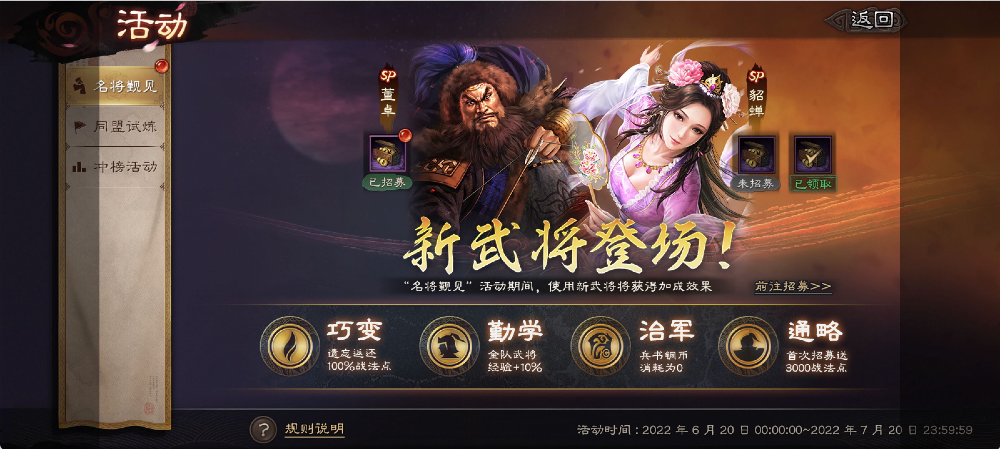
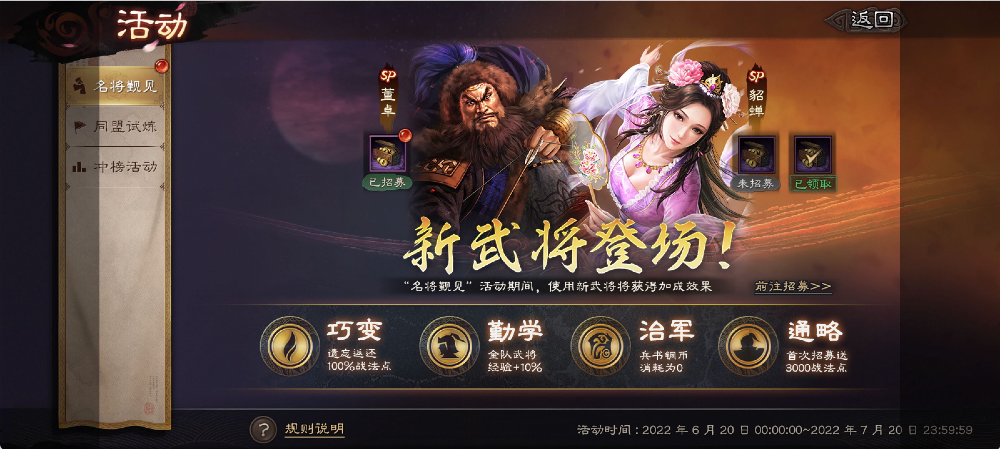
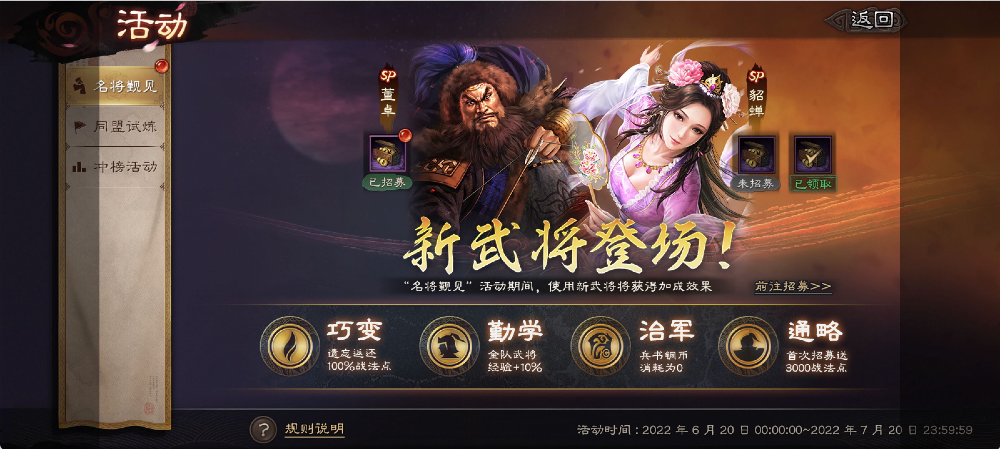
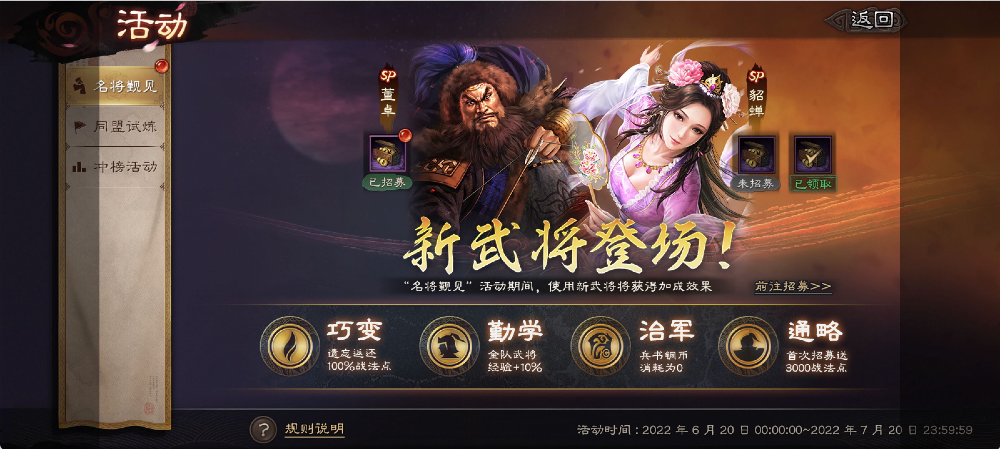

---------- TextMessage (assistant) ----------
这是一幅游戏活动界面的图片，主题是“新武将登场”。图片中展示了两位角色：一位是穿着厚重皮毛的男子，另一位是穿着华丽传统服饰的女子。左侧是活动菜单，列出“名将靡见”、“同盟试炼”和“冲榜活动”等选项。下方有四个功能图标，分别标注“巧变”、“勤学”、“治军”和“通路”，描述了活动中可获得的不同增益效果。界面底部显示了活动时间：2022年6月20日至2022年7月20日。整体风格具有古典气息。
[Prompt tokens: 4664, Completion tokens: 150]
---------- Summary ----------
Number of messages: 2
Finish reason: None
Total prompt tokens: 4664
Total completion tokens: 150
Duration: 23.04 seconds


In [13]:
async def assistant_run_stream() -> None:
    # Option 1: read each message from the stream (as shown in the previous example).
    # async for message in agent.run_stream(task="Find information on AutoGen"):
    #     print(message)

    # Option 2: use Console to print all messages as they appear.
    await Console(
        agent.run_stream(task=multi_modal_message),
        output_stats=True,  # Enable stats printing.
    )


# Use asyncio.run(assistant_run_stream()) when running in a script.
await assistant_run_stream()